In [1]:
import os

# Change to the working directory
%cd /content

# Clone the MODNet repository if it hasn't been cloned
if not os.path.exists('MODNet'):
    !git clone https://github.com/ZHKKKe/MODNet
%cd MODNet/

# Download the pretrained MODNet checkpoint if it doesn't exist
pretrained_ckpt = 'pretrained/modnet_webcam_portrait_matting.ckpt'
if not os.path.exists(pretrained_ckpt):
    !gdown --id 1Nf1ZxeJZJL8Qx9KadcYYyEmmlKhTADxX -O pretrained/modnet_webcam_portrait_matting.ckpt


/content
Cloning into 'MODNet'...
remote: Enumerating objects: 276, done.
remote: Counting objects: 100% (276/276), done.
remote: Compressing objects: 100% (162/162), done.
remote: Total 276 (delta 102), reused 252 (delta 95), pack-reused 0 (from 0)
Receiving objects: 100% (276/276), 60.77 MiB | 28.41 MiB/s, done.
Resolving deltas: 100% (102/102), done.
/content/MODNet
/usr/local/lib/python3.11/dist-packages/gdown/__main__.py:140: FutureWarning: Option `--id` was deprecated in version 4.3.1 and will be removed in 5.0. You don't need to pass it anymore to use a file ID.
  warnings.warn(
Downloading...
From: https://drive.google.com/uc?id=1Nf1ZxeJZJL8Qx9KadcYYyEmmlKhTADxX
To: /content/MODNet/pretrained/modnet_webcam_portrait_matting.ckpt
100% 26.3M/26.3M [00:00<00:00, 84.3MB/s]


In [2]:
import cv2
import numpy as np
import torch
import torch.nn as nn
import torchvision.transforms as transforms
from src.models.modnet import MODNet
from PIL import Image

# Set device to GPU if available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Load the MODNet model and checkpoint
modnet = MODNet(backbone_pretrained=False).to(device)

# Load the pretrained weights with a fix for `DataParallel`-related issues
checkpoint = torch.load('/content/MODNet/pretrained/modnet_webcam_portrait_matting.ckpt', map_location=device)

# Remove `module.` prefix if it exists
from collections import OrderedDict
new_state_dict = OrderedDict()
for k, v in checkpoint.items():
    name = k.replace("module.", "")  # Remove 'module.' prefix if present
    new_state_dict[name] = v
modnet.load_state_dict(new_state_dict)

modnet.eval()

# Define image transforms
torch_transforms = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
])


<ipython-input-2-b8774e0d74f5>:16: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  checkpoint = torch.load('/content/MODNet/pretrained/modnet_webcam_portrait_matting.ckpt', ma

In [3]:
def modnet_matting(modnet, frame):
    # Resize the frame to be divisible by 32 (for MODNet compatibility)
    height, width = frame.shape[:2]
    new_height = (height // 32) * 32
    new_width = (width // 32) * 32
    resized_frame = cv2.resize(frame, (new_width, new_height))

    # Convert resized frame (OpenCV) to PIL format and apply transformations
    frame_pil = Image.fromarray(cv2.cvtColor(resized_frame, cv2.COLOR_BGR2RGB))
    frame_tensor = torch_transforms(frame_pil).unsqueeze(0).to(device)

    # Run MODNet inference
    with torch.no_grad():
        _, _, matte = modnet(frame_tensor, inference=True)

    # Resize matte back to the original frame size
    matte = matte[0][0].cpu().numpy()
    matte_resized = cv2.resize(matte, (width, height))

    # Create foreground by applying matte
    fg_np = (matte_resized[..., np.newaxis] * frame + (1 - matte_resized[..., np.newaxis]) * 255).astype(np.uint8)

    return fg_np


In [4]:
def main(input_video_path, output_video_path):
    # Load input video
    cap = cv2.VideoCapture(input_video_path)
    frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps = cap.get(cv2.CAP_PROP_FPS)
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

    # Prepare output video writer
    out = cv2.VideoWriter(output_video_path, cv2.VideoWriter_fourcc(*'mp4v'), fps, (frame_width, frame_height))

    print(f"Video Properties:\n - Resolution: {frame_width}x{frame_height}\n - FPS: {fps}\n - Total Frames: {total_frames}")

    # Process each frame
    frame_count = 0
    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Apply MODNet matting
        fg_frame = modnet_matting(modnet, frame)

        # Write frame to output video
        out.write(fg_frame)

        frame_count += 1
        if frame_count % 50 == 0:
            print(f"Processed frame {frame_count}/{total_frames}")

    # Release resources
    cap.release()
    out.release()
    print("Processing complete. Output saved to:", output_video_path)


In [8]:
# Define input and output video paths
input_video_path = '/content/Test.mp4'  # Replace with your input video path
output_video_path = '/content/output_bg_removed2.mp4'

# Run the main function
main(input_video_path, output_video_path)


Video Properties:
 - Resolution: 1440x2560
 - FPS: 30.33641291228686
 - Total Frames: 90
Processed frame 50/90
Processing complete. Output saved to: /content/output_bg_removed2.mp4


29 min for output


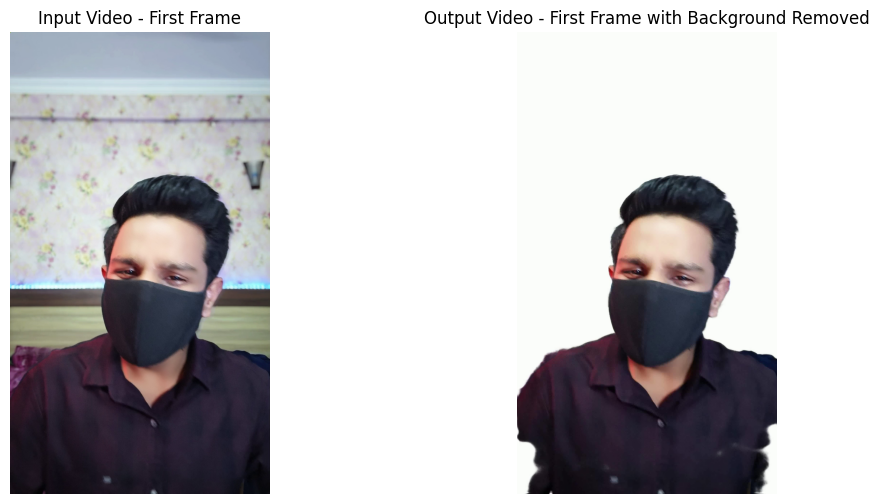

Input Video:


Output Video:


In [11]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
from IPython.display import HTML
from base64 import b64encode

# Define input and output video paths
input_video_path = '/content/Test.mp4'  # Replace with your input video path
output_video_path = '/content/output_bg_removed2.mp4'

# Function to encode video for display in Jupyter Notebook
def encode_video(video_path):
    video_file = open(video_path, "rb").read()
    video_url = "data:video/mp4;base64," + b64encode(video_file).decode()
    return video_url

# Load the input and output videos
cap_in = cv2.VideoCapture(input_video_path)
cap_out = cv2.VideoCapture(output_video_path)

# Check if videos loaded successfully
if not cap_in.isOpened() or not cap_out.isOpened():
    print("Error: Could not open one or both of the video files.")
else:
    # Read the first frame from both videos
    ret_in, frame_in = cap_in.read()
    ret_out, frame_out = cap_out.read()

    # Convert frames to RGB for matplotlib visualization
    if ret_in and ret_out:
        frame_in_rgb = cv2.cvtColor(frame_in, cv2.COLOR_BGR2RGB)
        frame_out_rgb = cv2.cvtColor(frame_out, cv2.COLOR_BGR2RGB)

        # Plot the first frame comparison side-by-side
        fig, axs = plt.subplots(1, 2, figsize=(12, 6))
        axs[0].imshow(frame_in_rgb)
        axs[0].set_title("Input Video - First Frame")
        axs[0].axis("off")

        axs[1].imshow(frame_out_rgb)
        axs[1].set_title("Output Video - First Frame with Background Removed")
        axs[1].axis("off")

        plt.show()

    else:
        print("Error: Could not read frames from one or both videos.")

    # Release video resources
    cap_in.release()
    cap_out.release()

# Display the input and output videos side by side
input_video_html = HTML(f"""<video width="320" height="240" controls>
                                <source src="{encode_video(input_video_path)}" type="video/mp4">
                                Your browser does not support the video tag.
                            </video>""")
output_video_html = HTML(f"""<video width="320" height="240" controls>
                                <source src="{encode_video(output_video_path)}" type="video/mp4">
                                Your browser does not support the video tag.
                            </video>""")

# Show both videos
print("Input Video:")
display(input_video_html)
print("Output Video:")
display(output_video_html)
